In [10]:
import gym
import CartPoleContinuous
import random

In [11]:
env = gym.make("CartPoleContinuous-v0")

In [12]:
obs = env.reset(seed=42)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:199: UserWarning: WARN: The result returned by `env.reset()` should be `(obs, info)` by default, , where `obs` is a observation and `info` is a dictionary containing additional information.
  logger.warn(


In [13]:
print(obs)

(array([ 0.0273956 , -0.00611216,  0.03585979,  0.0197368 ], dtype=float32),)


In [14]:
try:
    import pyvirtualdisplay
    display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()
except ImportError:
    pass

In [15]:
img = env.render('rgb_array')

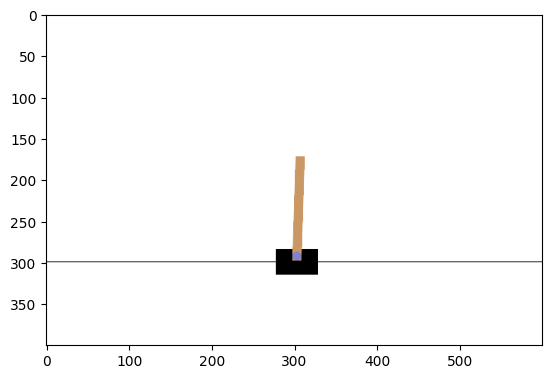

In [16]:
import matplotlib.pyplot as plt
plt.imshow(img)

In [17]:
env.action_space

Box(-1.0, 1.0, (1,), float32)

In [19]:
action = [1] # accelerate right
obs, reward, done, info = env.step(action)
obs

array([ 0.02824631,  0.1884764 ,  0.03484875, -0.26138783], dtype=float32)

In [20]:
import os

IMAGES_PATH = "./"

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

Saving figure cart_pole_plot


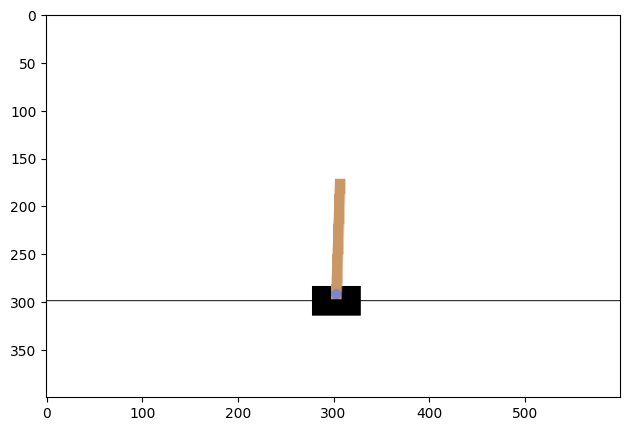

In [22]:
plt.imshow(env.render('rgb_array'))
save_fig("cart_pole_plot")

In [23]:
print(reward)
print(done)
info

1.0
False


False

In [24]:
if done:
    obs = env.reset()

In [25]:
def plotError(rewards: list[float]) -> None:
    plt.figure()
    plt.hist(rewards, bins=30, color='skyblue', edgecolor='black')
    plt.xlabel("episode")
    plt.ylabel("reward")
    plt.legend()
    plt.show()

In [26]:
def basic_policy(obs):
    theta_dot = obs[3]
    theta = obs[2]
    if theta_dot < 0 and theta < 0: return 0 # If falling left and facing left, move left
    if theta_dot > 0 and theta > 0: return 1 # If falling right and facing right, move right
    else: return random.randint(0, 1)


totals = []
frames = []
for episode in range(10):
    episode_rewards = 0
    obs = env.reset(seed=42)
    for step in range(10_000):
        img = env.render('rgb_array')
        frames.append(img)
        action = basic_policy(obs)
        obs, reward, done, info = env.step(action)
        episode_rewards += reward
        if done:
            break
    totals.append(episode_rewards)

plotError(totals)

TypeError: CartPoleEnv.render() got an unexpected keyword argument 'mode'

In [ ]:
import numpy as np

np.mean(totals), np.std(totals), np.min(totals), np.max(totals)

(480.1, 43.38306121056927, 354.0, 500.0)

In [ ]:
# To get smooth animations
%matplotlib inline
import matplotlib as mpl
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [ ]:
plot_animation(frames)

In [ ]:
print(env.observation_space.shape[0])

In [ ]:
import tensorflow as tf
print(tf.__version__)

# What does a random policy result in

First we will initialize a method for plotting the rewards over the course of many episodes of training and run it to plot the rewards over the course of the n_episodes * 10.

This results in a mean of ~22 steps before death

In [ ]:
def plotError(rewards: list[float]) -> None:
    plt.figure()
    plt.hist(rewards, bins=30, color='skyblue', edgecolor='black')
    plt.xlabel("episode")
    plt.ylabel("reward")
    plt.legend()
    plt.show()

In [ ]:
rewards = []

n_episodes = 5_000
for episode in range(n_episodes * 10):
    observation = env.reset()
    done = False
    total_reward = 0

    while not done:
        action = env.action_space.sample()  # Take a random action
        observation, reward, done, info = env.step(action)
        total_reward += reward

    rewards.append(total_reward)

plotError(rewards)
print(np.mean(rewards))

# Defining a DQN Class

I intend to explore the keras metrics library as my DQN has not been learning quickly (it may learn after more steps but I don't have the runtime efficiency to wait that long) in order to check in on why my DQN seems to not be learning. For now I'll simply outline what the class for the DQN Model object would look like.

In [ ]:
from collections import deque
import numpy as np
import random
from datetime import datetime

from tensorflow import keras
from keras.layers import Dense, BatchNormalization
from keras.models import Sequential, load_model
from keras.optimizers import Adam

# Get the size of state and action spaces
state_size = env.observation_space.shape[0]
action_size = env.action_space.n

class DQNAgent:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)  # Increase memory size for better experience replay
        self.gamma = 0.95  # Discount rate
        self.epsilon = 1.0  # Exploration rate
        self.epsilon_decay = 0.999995  # Adjust decay rate to reach ~0.05 after 500k steps
        self.epsilon_min = 0.05
        self.learning_rate = 0.001
        self.model = self._build_model()
        self.target_model = self._build_model()  # Target network
        self.update_target_model()  # Initialize target model weights

    def _build_model(self):
        # Neural Net for Deep-Q learning Model
        model = Sequential()
        model.add(Dense(4, input_dim=self.state_size, activation='relu'))
        model.add(Dense(self.action_size, activation='softmax'))
        model.compile(loss='mse', optimizer=Adam(learning_rate=self.learning_rate))
        return model

    def update_target_model(self):
        # Copy weights from model to target_model
        self.target_model.set_weights(self.model.get_weights())

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        act_values = self.model.predict(state, verbose=0)
        return np.argmax(act_values[0])

    def replay(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)

        times = [[],[]]
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
                target = (reward + self.gamma * np.amax(self.target_model.predict(next_state, verbose=0)[0]))
            t1 = datetime.now()
            target_f = self.model.predict(state, verbose=0)
            t2 = datetime.now()
            ms1 = (t2 - t1).total_seconds() * 1000
            target_f[0][action] = target

            t1 = datetime.now()
            self.model.fit(state, target_f, epochs=1, verbose=0)
            t2 = datetime.now()
            ms2 = (t2 - t1).total_seconds() * 1000
        times[0].append(ms1) # How long predict() took
        times[1].append(ms2) # How long fit() took

        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def train(self, batch_size, time, update_target_every=50_000):
        if len(self.memory) > batch_size:
            self.replay(batch_size)
        # Update the target model every 'update_target_every' episodes
        if time % update_target_every == 0:
            self.update_target_model()

# Q-Learning Model

Using the Bellman Equation: V(s) = max(R(s,a) + γV(s')) we will update a table mapping every state or an action which should be taken at that state and to ensure it continues exploring new states we will use an epsilon-greedy strategy.

In [ ]:
import numpy as np # used for arrays
import gym # pull the environment
import time # to get the time
import math # needed for calculations

env = gym.make("CartPole-v1")
print(env.action_space.n)

lr = 0.1
epsilon = 1
epsilon_decay_value = 0.99995
discount = 0.995
n_episodes = 100_000
total = 0
total_reward = 0
prior_reward = 0

Observation = [30, 30, 50, 50]
np_array_win_size = np.array([0.25, 0.25, 0.01, 0.1])


n_in = np.prod(Observation)  # Product of dimensions for observation space
n_out = env.action_space.n  # Number of actions
variance = 2.0 / (n_in + n_out) # Xavier initialization variance
q_table = np.random.normal(loc=0, scale=np.sqrt(variance), size=(Observation + [env.action_space.n]))
q_table.shape

def get_discrete_state(state):
    discrete_state = state/np_array_win_size+ np.array([15,10,1,10])
    return tuple(discrete_state.astype(int))

rewards = []
for episode in range(n_episodes + 1): # go through the episodes
    t0 = time.time() # set the initial time
    discrete_state = get_discrete_state(env.reset()) # get the discrete start for the restarted environment
    done = False
    episode_reward = 0 # reward starts as 0 for each episode

    if episode % 2000 == 0:
        print("=== Episode: " + str(episode))

    while not done:

        if np.random.random() > epsilon:
            action = np.argmax(q_table[discrete_state]) # take cordinated action
        else:
            action = np.random.randint(0, env.action_space.n) # do a random ation

        new_state, reward, done, _ = env.step(action) # step action to get new states, reward, and the "done" status.
        episode_reward += reward # add the reward
        new_discrete_state = get_discrete_state(new_state)

        if episode % 2000 == 0: # render
            env.render()

        if not done: # update q-table
            max_future_q = np.max(q_table[new_discrete_state])
            current_q = q_table[discrete_state + (action,)]
            new_q = (1 - lr) * current_q + lr * (reward + discount * max_future_q)
            q_table[discrete_state + (action,)] = new_q
        discrete_state = new_discrete_state

    if epsilon > 0.05: # epsilon modification
        if episode_reward > prior_reward and episode > 10000:
            epsilon = math.pow(epsilon_decay_value, episode - 10000)
            if episode % 500 == 0:
                print("Epsilon: " + str(epsilon))

    t1 = time.time() # episode has finished
    episode_total = t1 - t0 # episode total time
    total = total + episode_total

    total_reward += episode_reward # episode total reward
    prior_reward = episode_reward

    if episode % 1000 == 0: # every 1000 episodes print the average time and the average reward
        mean = total / 1000
        print("Avg time taken: " + str(mean))

        mean_reward = total_reward / 1000
        print("Mean Reward Achieved: " + str(mean_reward))
        rewards.append(mean_reward)
        total_reward = 0
env.close()


2


/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/usr/local/lib/python3.10/dist-packages/gym/core.py:49: DeprecationWarning: WARN: You are calling render method, but you didn't specified the argument render_mode at environme

=== Episode: 0
Avg time taken: 0.001571601629257202
Mean Reward Achieved: 0.024
Avg time taken: 0.0025579724311828615
Mean Reward Achieved: 22.161
=== Episode: 2000
Avg time taken: 0.0038838222026824952
Mean Reward Achieved: 21.996
Avg time taken: 0.00533846116065979
Mean Reward Achieved: 22.229
=== Episode: 4000
Avg time taken: 0.006869737386703491
Mean Reward Achieved: 22.309
Avg time taken: 0.007772537231445312
Mean Reward Achieved: 21.826
=== Episode: 6000
Avg time taken: 0.00926933717727661
Mean Reward Achieved: 21.963
Avg time taken: 0.01021476149559021
Mean Reward Achieved: 22.109
=== Episode: 8000
Avg time taken: 0.01138028883934021
Mean Reward Achieved: 22.782
Avg time taken: 0.012320906162261962
Mean Reward Achieved: 22.626
=== Episode: 10000
Avg time taken: 0.014289459228515626
Mean Reward Achieved: 22.493
Epsilon: 0.9512282354250458
Avg time taken: 0.015215051174163819
Mean Reward Achieved: 22.638
Epsilon: 0.9277417467531685
=== Episode: 12000
Avg time taken: 0.017077253818

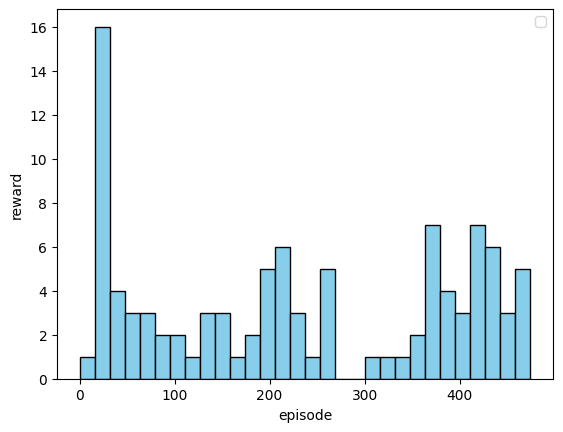

In [ ]:
plotError(rewards)

In [ ]:
# Modify the training loop to include target model update logic
n_episodes = 10  # Increase the number of episodes if necessary
agent = DQNAgent(state_size, action_size)
done = False
batch_size = 10  # Adjust batch size if necessary
rewards = []

for e in range(n_episodes):
    state = env.reset()
    state = np.reshape(state, [1, state_size])
    for time in range(500):  # Max time steps
        print("----> t= ", time)

        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        next_state = np.reshape(next_state, [1, state_size])
        agent.remember(state, action, reward, next_state, done)

        state = next_state
        if done:
            rewards.append(time)
            print("EPISODE: {}/{}, SCORE: {}, e: {:.2}".format(e, n_episodes, time, agent.epsilon))
            break
        agent.train(batch_size, time, update_target_every=50_000)  # Update target model every 50_000 episodes


----> t=  0
----> t=  1
----> t=  2
----> t=  3
----> t=  4
----> t=  5
----> t=  6
----> t=  7
----> t=  8
----> t=  9
----> t=  10
----> t=  11
----> t=  12
----> t=  13
----> t=  14
----> t=  15
----> t=  16
----> t=  17
----> t=  18
----> t=  19
----> t=  20
----> t=  21
EPISODE: 0/10, SCORE: 21, e: 1.0
----> t=  0
----> t=  1
----> t=  2
----> t=  3
----> t=  4
----> t=  5
----> t=  6
----> t=  7
----> t=  8
----> t=  9
----> t=  10
----> t=  11
----> t=  12
----> t=  13
----> t=  14
----> t=  15
----> t=  16
EPISODE: 1/10, SCORE: 16, e: 1.0
----> t=  0
----> t=  1
----> t=  2
----> t=  3
----> t=  4
----> t=  5
----> t=  6
----> t=  7
----> t=  8
----> t=  9
----> t=  10
----> t=  11
----> t=  12
----> t=  13
----> t=  14
----> t=  15
----> t=  16
----> t=  17
----> t=  18
----> t=  19
----> t=  20
----> t=  21
----> t=  22
----> t=  23
----> t=  24
----> t=  25
----> t=  26
----> t=  27
----> t=  28
----> t=  29
----> t=  30
----> t=  31
----> t=  32
----> t=  33
----> t=  34
--

KeyboardInterrupt: 

In [ ]:
import numpy as np
import math

np_array_win_size = np.array([4.8, 5, 0.418, 1.57])

def round_away_from_zero(x):
    if x < 0: return math.floor(x)
    if x > 0: return math.ceil(x)
    else: return 0

def get_discrete_state(state):
    discrete_state = np.array(list(map(round_away_from_zero, state/np_array_win_size)))
    return discrete_state

state = np.array([4.8,  5,  0.418,  1.57]) # Vals
print(get_discrete_state(state))

[1 1 1 1]


In [ ]:
import torch
from torch import nn
from torch.nn import functional
from torch.utils.data import TensorDataset, DataLoader
import gym
from collections import deque
import random


class Model(nn.Module):
    def __init__(self, input_features, output_values):
        super(Model, self).__init__()
        self.fc1 = nn.Linear(in_features=input_features, out_features=32)
        self.fc2 = nn.Linear(in_features=32, out_features=32)
        self.fc3 = nn.Linear(in_features=32, out_features=output_values)

    def forward(self, x):
        x = functional.selu(self.fc1(x))
        x = functional.selu(self.fc2(x))
        x = self.fc3(x)
        return x

# Parameters
use_cuda = True
episode_limit = 100
target_update_delay = 2  # update target net every target_update_delay episodes
test_delay = 10
learning_rate = 1e-4
epsilon = 1  # initial epsilon
min_epsilon = 0.1
epsilon_decay = 0.9 / 2.5e3
gamma = 0.99
memory_len = 10000

env = gym.make('CartPole-v1')
n_features = len(env.observation_space.high)
n_actions = env.action_space.n

memory = deque(maxlen=memory_len)
# each memory entry is in form: (state, action, env_reward, next_state)
device = torch.device("cuda" if use_cuda and torch.cuda.is_available() else "cpu")
criterion = nn.MSELoss()
policy_net = Model(n_features, n_actions).to(device)
target_net = Model(n_features, n_actions).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()


def get_states_tensor(sample, states_idx):
    sample_len = len(sample)
    states_tensor = torch.empty((sample_len, n_features), dtype=torch.float32, requires_grad=False)

    features_range = range(n_features)
    for i in range(sample_len):
        for j in features_range:
            states_tensor[i, j] = sample[i][states_idx][j].item()

    return states_tensor


def normalize_state(state):
    state[0] /= 2.5
    state[1] /= 2.5
    state[2] /= 0.3
    state[3] /= 0.3


def state_reward(state, env_reward):
    return env_reward - (abs(state[0]) + abs(state[2])) / 2.5


def get_action(state, e=min_epsilon):
    if random.random() < e:
        # explore
        action = random.randrange(0, n_actions)
    else:
        state = torch.tensor(state, dtype=torch.float32, device=device)
        action = policy_net(state).argmax().item()

    return action


def fit(model, inputs, labels):
    inputs = inputs.to(device)
    labels = labels.to(device)
    train_ds = TensorDataset(inputs, labels)
    train_dl = DataLoader(train_ds, batch_size=5)

    optimizer = torch.optim.Adam(params=model.parameters(), lr=learning_rate)
    model.train()
    total_loss = 0.0

    for x, y in train_dl:
        out = model(x)
        loss = criterion(out, y)
        total_loss += loss.item()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    model.eval()

    return total_loss / len(inputs)


def optimize_model(train_batch_size=100):
    train_batch_size = min(train_batch_size, len(memory))
    train_sample = random.sample(memory, train_batch_size)

    state = get_states_tensor(train_sample, 0)
    next_state = get_states_tensor(train_sample, 3)

    q_estimates = policy_net(state.to(device)).detach()
    next_state_q_estimates = target_net(next_state.to(device)).detach()

    for i in range(len(train_sample)):
        q_estimates[i][train_sample[i][1]] = (state_reward(next_state[i], train_sample[i][2]) +
                                              gamma * next_state_q_estimates[i].max())

    fit(policy_net, state, q_estimates)


def train_one_episode():
    global epsilon
    current_state = env.reset()
    normalize_state(current_state)
    done = False
    score = 0
    reward = 0
    while not done:
        action = get_action(current_state, epsilon)
        next_state, env_reward, done, _ = env.step(action)
        normalize_state(next_state)
        memory.append((current_state, action, env_reward, next_state))
        current_state = next_state
        score += env_reward
        reward += state_reward(next_state, env_reward)

        optimize_model(100)

        epsilon -= epsilon_decay

    return score, reward


def test():
    state = env.reset()
    normalize_state(state)
    done = False
    score = 0
    reward = 0
    while not done:
        action = get_action(state)
        state, env_reward, done, _ = env.step(action)
        normalize_state(state)
        score += env_reward
        reward += state_reward(state, env_reward)

    return score, reward


best_test_reward = 0

for i in range(episode_limit):
    score, reward = train_one_episode()

    print(f'Episode {i + 1}: score: {score} - reward: {reward}')

    if i % target_update_delay == 0:
        target_net.load_state_dict(policy_net.state_dict())
        target_net.eval()

    if (i + 1) % test_delay == 0:
        test_score, test_reward = test()
        print(f'Test Episode {i + 1}: test score: {test_score} - test reward: {test_reward}')
        if test_reward > best_test_reward:
            print('New best test reward. Saving model')
            best_test_reward = test_reward
            torch.save(policy_net.state_dict(), 'policy_net.pth')

if episode_limit % test_delay != 0:
    test_score, test_reward = test()
    print(f'Test Episode {episode_limit}: test score: {test_score} - test reward: {test_reward}')
    if test_reward > best_test_reward:
        print('New best test reward. Saving model')
        best_test_reward = test_reward
        torch.save(policy_net.state_dict(), 'policy_net.pth')

print(f'best test reward: {best_test_reward}')

/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Episode 1: score: 34.0 - reward: 31.356111053004863
Episode 2: score: 19.0 - reward: 16.476883840560916
Episode 3: score: 23.0 - reward: 20.148333180695772
Episode 4: score: 11.0 - reward: 9.467684119939804
Episode 5: score: 11.0 - reward: 9.755114199221136
Episode 6: score: 19.0 - reward: 16.697664850950243
Episode 7: score: 20.0 - reward: 17.431027887016537
Episode 8: score: 15.0 - reward: 13.415257822722193
Episode 9: score: 12.0 - reward: 9.957355996966362
Episode 10: score: 59.0 - reward: 50.27422853410244
Test Episode 10: test score: 144.0 - test reward: 115.93910026550296
New best test reward. Saving model
Episode 11: score: 12.0 - reward: 10.809137495979666
Episode 12: score: 46.0 - reward: 40.68491509407759
Episode 13: score: 15.0 - reward: 13.554334071278573
Episode 14: score: 20.0 - reward: 16.36558256149292
Episode 15: score: 65.0 - reward: 58.92463491708039
Episode 16: score: 16.0 - reward: 14.225053857266904
Episode 17: score: 23.0 - reward: 20.42311611920595
Episode 18: 